In [312]:
def is_colab():
    try:
        import google.colab
        from google.colab import output
        output.enable_custom_widget_manager()
        return True
    except ImportError:
        return False

if is_colab():
    !git clone https://github.com/adishourya/SaliencyAnalysisHackathonIDS
    %cd SaliencyAnalysisHackathonIDS
    print("==="*10)
    !ls
else:
    print("Not running in Colab specific code")


Not running in Colab specific code


In [313]:
#========= Mine

In [314]:
import os
import random
from IPython.display import HTML
from functools import partial
from libs.utils import run_test, bidict
from libs.sollutions.notebook1 import solved_saliency_time
from libs.utils import (CLASS_MAPPING, IMG_PATH_PICKER,plot_picked_img,plot_maps)
from IPython.display import Image, display



import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision.io import decode_image
import torchvision
import einops
import matplotlib.pyplot as plt
import plotly
import plotly.graph_objects as go
import plotly.express as px

import ipywidgets as widgets
from ipywidgets import interact
random.seed(0)
torch.manual_seed(0)


In [315]:
CLASS_MAPPING

{'Butterfly': 0,
 'Cat': 1,
 'Chicken': 2,
 'Cow': 3,
 'Dog': 4,
 'Elephant': 5,
 'Horse': 6,
 'Sheep': 7,
 'Spider': 8,
 'Squirrel': 9}

In [316]:
HTML("""
<H1 align="center">Puzzle Based Notebooks</H1>
""")

In [317]:
# get your inference model
# inspect your model
from libs.saliency_methods.load_model import get_conv_model, test_model
model = get_conv_model()
model.eval()

SmallCNN(
  (conv1): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (gn1): GroupNorm(1, 32, eps=1e-05, affine=True)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (gn2): GroupNorm(1, 64, eps=1e-05, affine=True)
  (conv3): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (gn3): GroupNorm(1, 128, eps=1e-05, affine=True)
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (adapt): AdaptiveAvgPool2d(output_size=(4, 4))
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=2048, out_features=10, bias=True)
)

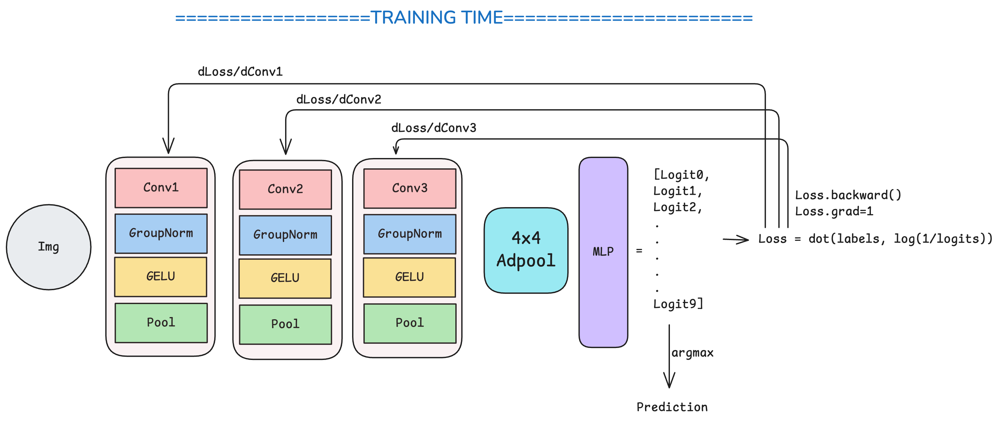

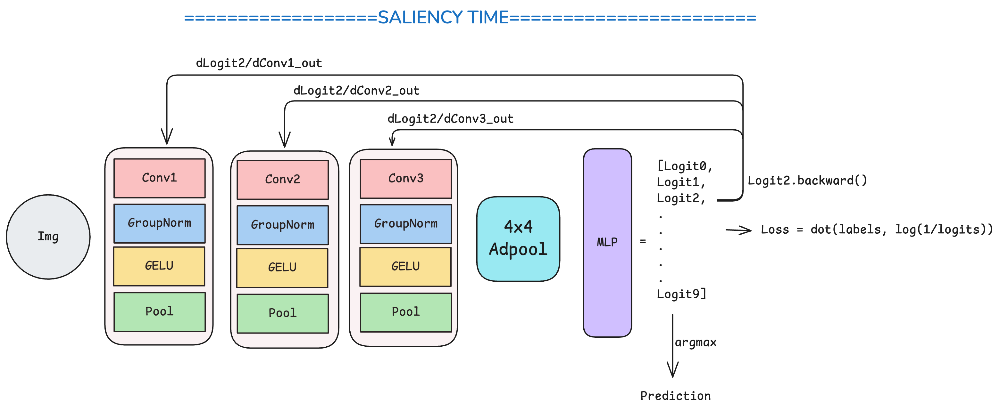

In [318]:
HTML("""
<H1> Saliency approaches are often Gradient Based <H1>
<H2> And these gradients are not the same gradients that we calculate at training time </H2>
""")
display(Image(filename="assets/TrainingTime.png", height=500, width=800))
display(Image(filename="assets/SaliencyTime.png", height=500,width=800))

In [319]:
HTML("""
<H2> QUIZ ON SALIENCY GRADIENTS </H3>
""")

In [320]:
def SaliencyTimeQuiz():
    """
    What would be the output of logit2.grad
    during saliency time
    """
    return "Change Me"

run_test(SaliencyTimeQuiz,solved_saliency_time)


In [321]:
display(IMG_PATH_PICKER)

Dropdown(description='choose_image', index=13, options=('libs/datasets_and_models/sample_animals10/cat/1307.jp…

In [322]:
img = decode_image(IMG_PATH_PICKER.value,mode="RGB")
plot_picked_img(img)
# resize the image depending on the input size of the model
img = einops.rearrange(img,"c h w -> 1 c h w")
img = torch.nn.functional.interpolate(img,size=(128,128))
print(img.shape)

torch.Size([1, 3, 128, 128])


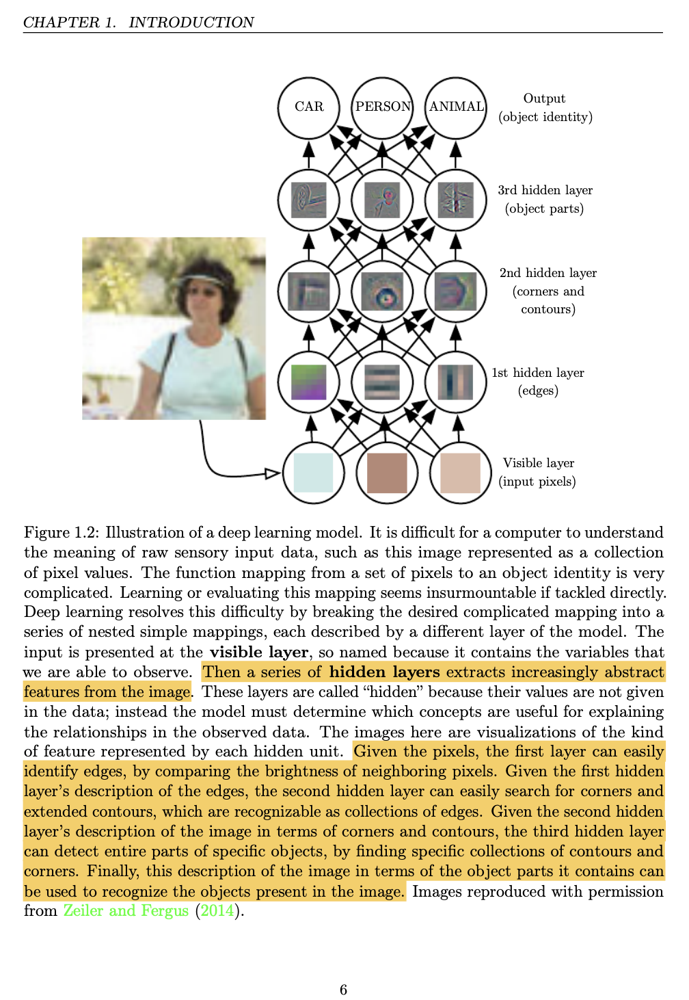

In [323]:
display(Image("./assets/ian_target_layer.png",height=500))
HTML("""
<!-- <img src="./assets/ian_target_layer.png" height="100"> -->
<p align="right" style="font-size:10px;">
    Page From Ian Goodfellow, Yoshua Bengio, Aaron Courville's Deep Learning Book
</p>
""")


In [324]:
target_layer = model.conv3 # last conv module of our model
logit_idx = CLASS_MAPPING["Cat"] # this is the index, we would be calling backward on

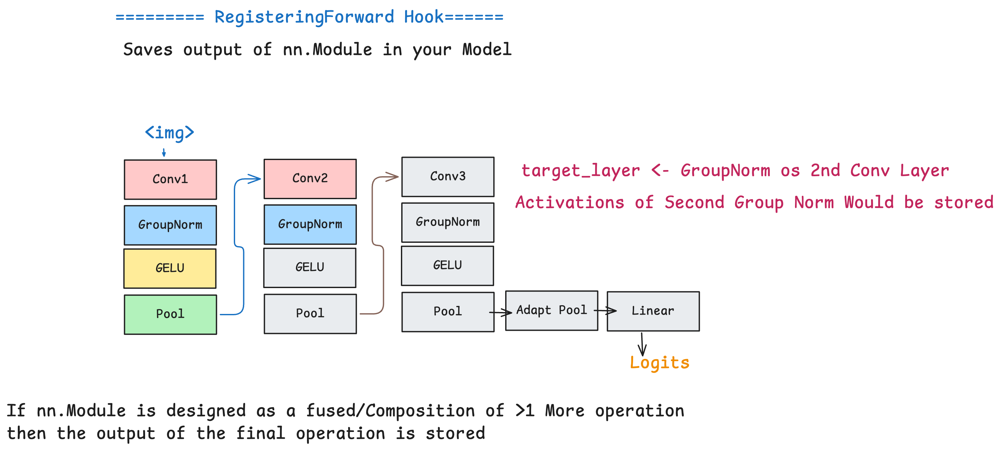

In [325]:
# registering Hooks
display(Image("./assets/FWDHOOKS.png",height=500))

In [326]:

#========= Pytorchs FWD Hook
global activations #<--- Pytorchs accumulationn


def save_activation(module,input,output):
    global activations
    activations = output.detach()

target_layer.register_forward_hook(save_activation)

# ( Perform Forward Pass)
logits = model(img.to(torch.float32))
predicted_idx = torch.argmax(logits,dim=-1)
predicted_label = CLASS_MAPPING.inverse[int(predicted_idx)]

print(logits,predicted_idx)
print(f"Prediction {predicted_label}")


#========= Your FWD Hook
def fwd_hook_puzzle(img):
    """
    Comment out the lines from the fwd pass
    that you think is not collected in activations
    for fwd hook on `target_layer = model.conv3`
    """
    with torch.no_grad():
        pool = torch.nn.MaxPool2d(2,2)
        gn1 = torch.nn.GroupNorm(1,32)
        gn2 = torch.nn.GroupNorm(1,64)
        gn3 = torch.nn.GroupNorm(1,128)

        # layer1 fwd
        x = img.to(torch.float32)
        x = model.conv1(x)
        x = gn1(x)
        x = F.gelu(x)
        x = pool(x)

        #layer2 fwd
        x = model.conv2(x)
        x = gn2(x)
        x = F.gelu(x)
        x = pool(x)

        # layer3 fwd
        x = model.conv3(x)
        x = gn3(x)
        # x = F.gelu(x)
        # x = pool(x)

        return x

# dont touch!!!!!!!!!
# comparing yours and torchs
your_activations = fwd_hook_puzzle(img)
print(your_activations.shape,activations.shape)
result = torch.allclose(your_activations,activations,atol=1e-8)
run_test(lambda: result , lambda: True)

tensor([[ 2.2063, -0.4590, -3.9341, -3.5659,  0.4757, -0.3754,  0.2909, -3.4143,
          0.4164,  0.3919]], grad_fn=<AddmmBackward0>) tensor([0])
Prediction ['Butterfly']
torch.Size([1, 128, 32, 32]) torch.Size([1, 128, 32, 32])


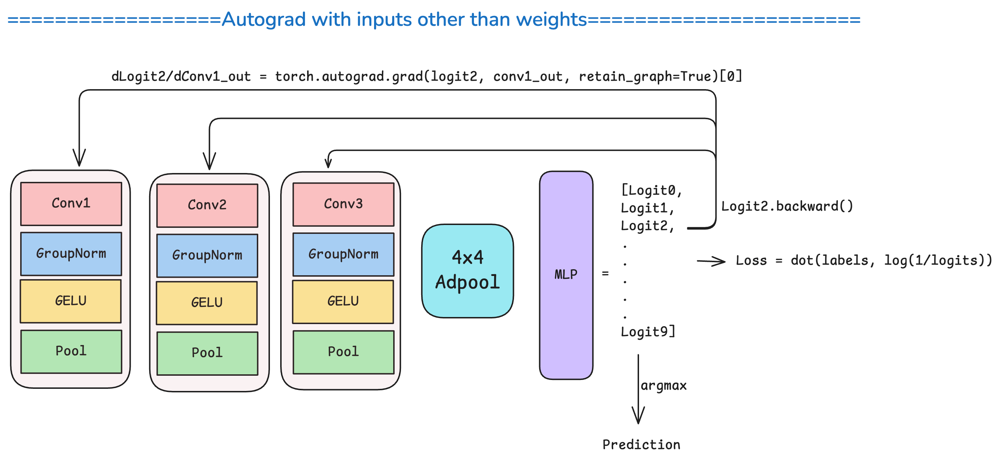

In [327]:
display(Image("./assets/AutoGradCalculation.png",height=500))

In [328]:
#========= Pytorchs Backward
def save_grad(module,grad_input,grad_output):
    global gradients
    gradients = grad_output[0].detach()

target_layer.register_full_backward_hook(save_grad)

# (Perform backward pass Backward Pass)
# note you need to perform fwd pass again after hooking
img = decode_image(IMG_PATH_PICKER.value,mode="RGB")
img = einops.rearrange(img,"c h w -> 1 c h w")
img = torch.nn.functional.interpolate(img,size=(128,128))

logits = model(img.to(torch.float32))
predicted_idx = torch.argmax(logits,dim=-1)
predicted_label = CLASS_MAPPING.inverse[int(predicted_idx)]

desired_logit = logits[0][logit_idx]
desired_logit.backward(retain_graph=True)


#=======Yours
def bwd_hook_puzzle(img, logit_idx):
    # perform your fwd pass and populate intermediate variables
    pool = model.pool
    gn1 = model.gn1
    gn2 = model.gn2
    gn3 = model.gn3
    conv1 = model.conv1
    conv2 = model.conv2
    conv3 = model.conv3
    adapt = model.adapt
    fc = model.fc

    # Layer 1
    conv1_out = model.conv1(img.float())
    gn_conv1 = model.gn1(conv1_out)
    a_conv1 = F.gelu(gn_conv1)
    p_conv1 = model.pool(a_conv1)

    # Layer 2
    conv2_out = model.conv2(p_conv1)
    gn_conv2 = model.gn2(conv2_out)
    a_conv2 = F.gelu(gn_conv2)
    p_conv2 = model.pool(a_conv2)

    # Layer 3
    conv3_out = model.conv3(p_conv2)
    gn_conv3 = model.gn3(conv3_out)
    a_conv3 = F.gelu(gn_conv3)
    p_conv3 = model.pool(a_conv3)

    # adaptive pooling
    ad_conv3 = model.adapt(p_conv3)
    fc = torch.flatten(ad_conv3, 1)
    logits = model.fc(fc)

    # ---- Compute true gradient w.r.t conv3 output ----
    desired_logit = logits[0, logit_idx]
    grad = torch.autograd.grad(desired_logit, a_conv3, retain_graph=True)[0] # Change Me?

    return grad



# dont touch!!!!!!!!!
your_gradients = bwd_hook_puzzle(img, logit_idx)
print(your_gradients.shape,gradients.shape)
result = torch.allclose(your_gradients,gradients,atol=1e-8)
run_test(lambda: result , lambda: True)



torch.Size([1, 128, 32, 32]) torch.Size([1, 128, 32, 32])


# Inspect Activations and Gradients

In [329]:
upscaled_gradients = torch.nn.functional.interpolate(gradients,(256,256))
upscaled_activations = torch.nn.functional.interpolate(activations,(256,256))
img = torch.nn.functional.interpolate(img,(256,256))

upscaled_gradients = einops.rearrange(upscaled_gradients,"1 o h w -> o h w")
upscaled_activations = einops.rearrange(upscaled_activations,"1 o h w -> o h w")
img = einops.rearrange(img,"1 c h w -> c h w")

In [330]:
grad_slider = widgets.IntSlider(0,0,upscaled_gradients.shape[0]-1,step=1,description="Output Mode")
widgets.interactive(
    lambda mode_idx: plot_maps(img,upscaled_gradients,"Raw Gradients", mode_idx),
    mode_idx=grad_slider
)

interactive(children=(IntSlider(value=0, description='Output Mode', max=127), Output()), _dom_classes=('widget…

In [331]:
act_slider = widgets.IntSlider(0,0,upscaled_activations.shape[0]-1,step=1,description="Output Mode")
widgets.interactive(
    lambda mode_idx: plot_maps(img,upscaled_activations,"Raw Activations", mode_idx),
    mode_idx=act_slider
)

interactive(children=(IntSlider(value=0, description='Output Mode', max=127), Output()), _dom_classes=('widget…

# GRADCAM

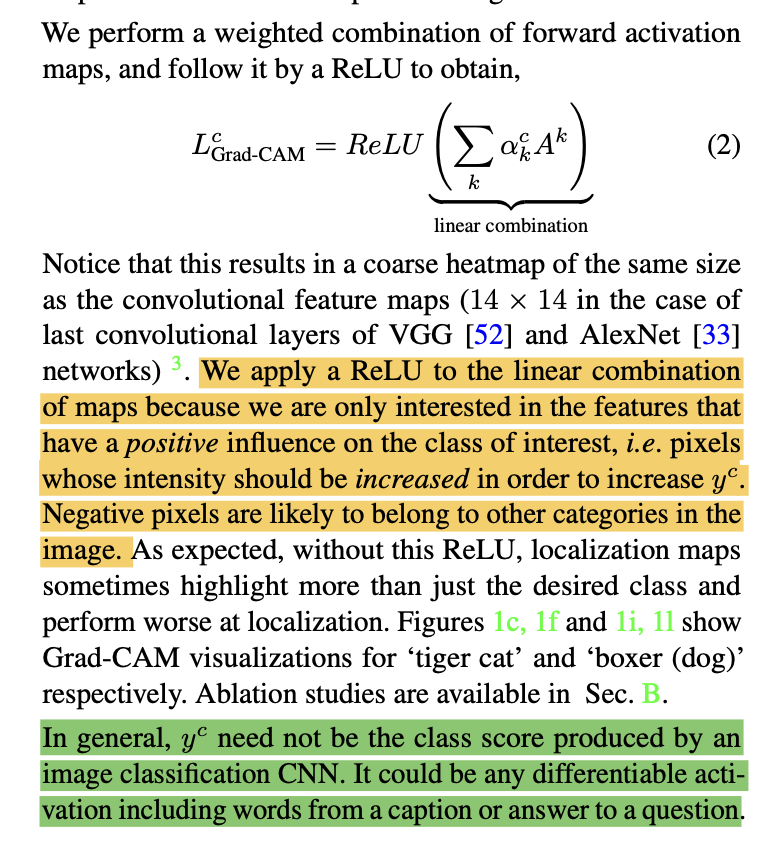

In [332]:
display(Image("./assets/relu_gradcam.png",height=500))

HTML("""
<p align="right" style="font-size:10px;">
From the authors of gradcam <a href="https://arxiv.org/pdf/1610.02391">Article </a>
</p>
""")

In [333]:
alpha_c = einops.reduce(upscaled_gradients, "c h w -> c 1 1","mean")
weighted_activations = alpha_c * upscaled_activations
weighted_activations = torch.relu(weighted_activations)

# why relu after and not before?
# Gradients may be positive in some spatial locations and negative in others. The mean of these gives the net importance of that feature map to the score.
# and then filtering with relu makes the CAM-map more localized.

slider2 = widgets.IntSlider(0,0,weighted_activations.shape[0]-1,step=1,description="Output Mode")
widgets.interactive(
    lambda mode_idx: plot_maps(img,weighted_activations,"Gated Saliency", mode_idx),
    mode_idx=slider2
)

interactive(children=(IntSlider(value=0, description='Output Mode', max=127), Output()), _dom_classes=('widget…

In [334]:
weighted_activations_fused = einops.reduce(weighted_activations,"o h w ->h w","mean").unsqueeze(0)
weighted_activations_fused = torch.where(
    weighted_activations_fused > weighted_activations_fused.quantile(0.75),
    weighted_activations_fused,0.0)
weighted_activations_fused = torchvision.transforms.functional.gaussian_blur(weighted_activations_fused,51)
# weighted_activations_fused = torch.min(weighted_activations,dim=0,keepdims=True)
plot_maps(img,weighted_activations_fused,"All Conv Kernels",0)

## Bonus CAM Method : EigenCAM

In [336]:
# eigencams (Bonus) : what if the basis of activations pointed towards the first eigen components

# perform signular value decomposition
U,S,V = torch.svd(einops.rearrange(activations,"1 c h w -> (h w) c"),compute_uv=True)
first_eigen_features = V.T[0]
# projection towards first eigen features
activations_lt = einops.rearrange(activations,"1 c h w -> (h w) c") @ first_eigen_features

# reshape and upscale
activations_lt = einops.rearrange(activations_lt, "(h w)->1 1 h w",h = 32,w=32)
activations_lt = torch.nn.functional.interpolate(activations_lt, (256,256))
activations_lt = einops.rearrange(activations_lt, "1 1 h w ->1 h w")


weighted_activations_lt = torch.sum(upscaled_gradients * activations_lt,dim=0,keepdims=True).relu()
weighted_activations_lt = torchvision.transforms.functional.gaussian_blur(weighted_activations_lt,51)
plot_maps(img,weighted_activations_lt,"EigenCam",0)